### Imports & utils

In [1]:
# uncomment if simulation in last section is needed
# import torch 
# torch.set_default_dtype(torch.float32)
# my_device = torch.device("cpu")

%matplotlib inline  
import subprocess
import sys

# install less commonly used packages, e.g. jax
def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

import numpy as np
from collections import namedtuple
import matplotlib.pylab as plt
import matplotlib.animation
from functools import partial

# uncomment if flow lenia and particle lenia is need
# try :   
#   import jax
#   import jax.numpy as jp
# except ModuleNotFoundError :
#   print('installing reikna, pyfftw, jax')
#   install("reikna")
#   install("pyfftw")
#   install("jax"); install("jaxlib")

# optional: make cells display wider
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

# import packages from other folders
from utils.simulation import Simulator, show_videofile
from utils.helper import load_from_json
from utils.lenia import lenia_origin_diagram, lenia_extended_diagram, lenia_multi_channel_diagram, lenia_coex_diagram, lenia_mass_diagram
from flow_lenia.fields import vmap2, animate_lenia 
from utils.Kernel import Kernel
from utils.Growth_fn import Growth_fn
from QCA.Semi_CA import *
from utils.entropy import *
from utils.restore import *
from utils.librarian import Librarian
lib = Librarian()

# prepare demonstration files
Params = namedtuple('Params', 'R, mu, sigma, size, dt, cells, b')
Params_f = namedtuple('Params_f', 'mu_k sigma_k w_k mu_g sigma_g c_rep dt')
orbium = load_from_json('./zoo/orbium.json')
orbium_params = Params(R=orbium["R"], mu=orbium["m"], sigma=orbium["s"], size=1<<6, dt=orbium["dt"], cells=orbium["cells"], b=orbium["b"])
# mass flow preparation
field_params = Params_f(mu_k=4.0, sigma_k=1.0, w_k=0.022, mu_g=0.6, sigma_g=0.15, c_rep=1.0, dt=0.1)


Reading JSON file ./zoo/orbium.json ...
Completed !


In [2]:
# helper function for direct simulation in notebook
def figure_world(A, titles, cmap='gray'):
    global img

    if titles == None:
        titles = ["Title!"]

    fig = plt.figure()
    # invert cmap
    A = 1-A
    img = plt.imshow(A, cmap=cmap, interpolation="nearest", vmin=0, vmax=1)
    plt.title(titles)
    plt.close()
    return fig

# 3. Energy conservation

To make the CA more physical we can think of more physics laws and encoded it in the algorithm:

* model dynamics through the lens of a greedy local energy minimization process, and compare the behavior of the model to that of running with an equivalent global energy minimization routine

* make analogy to Lennard-Jones particles to create both attraction and repulsion potentials

The second idea can be implemented with an extra repulsion field to suppress the maximum particle concentration. (as we have already the attraction force with growth potential)

The magnitude of force that repels two particles $i \neq j$ is $f_{ij} = f_{ji}= c_\text{rep}\max(1-\Vert\mathbf{p}_i-\mathbf{p}_j\Vert, 0)$, where $c_\text{rep}$ controls the repulsion strength. We can also represent this force with a *repulsion potential field* $\mathbf{R}^t$:

$$\mathbf{R}^t(\mathbf{x}) = \frac{c_\text{rep}}{2}\sum_{i: \mathbf{p}_i \neq \mathbf{x}} \max\big(1-\Vert \mathbf{x} - \mathbf{p}_i\Vert,\; 0\big)^2$$


With the total energy defined as $\mathbf{E}=\mathbf{R}-\mathbf{G}$, we can write down the dynamics of lenia as:

$$ \frac{d\mathbf{p}_i}{dt} = -∇\mathbf{E}(\mathbf{p}_i) = -\left[ \frac{∂\mathbf{E}(\mathbf{p}_i)}{∂\mathbf{p}_i} \right]^\top $$

And the code as follows:

In [12]:
Fields = namedtuple('Fields', 'U G R E')

def peak_f(x, mu, sigma):
  return jp.exp(-((x-mu)/sigma)**2)

def fields_f(p, points, x):
  r = jp.sqrt(jp.square(x-points).sum(-1).clip(1e-10))
  U = peak_f(r, p.mu_k, p.sigma_k).sum()*p.w_k
  G = peak_f(U, p.mu_g, p.sigma_g)
  R = p.c_rep/2 * ((1.0-r).clip(0.0)**2).sum()
  return Fields(U, G, R, E=R-G)

def motion_f(params, points):
  grad_E = jax.grad(lambda x : fields_f(params, points, x).E)
  return -jax.vmap(grad_E)(points)

Then to implement the gradient calculation we use [*JAX*](https://github.com/google/jax) because it has a really good function base for gradient descent compared to numpy. 

In [4]:
# set random seed for the world
# key = jax.random.PRNGKey(20)
# generates random points in the world
# points0 = (jax.random.uniform(key, [200, 2])-0.5)*12.0

 Field $\mathbf{U}$ below is generated in blue, with yellow overlay $\mathbf{G}$. Right visualization shows the evolution of the "energy" field $\mathbf{E}$. White color corresponds to the vacuum state. Red areas show higher energy levels produced by the repulsion field $\mathbf{R}$. In green areas the growth field $\mathbf{G}$ outweighs repulsion. The black dash on the colorbar corresponds to the average value of $\mathbf{E}$ at current particle locations.

In [13]:
dt = 0.1
# Euler method (Runge-Kutt first order)
def odeint_euler(f, params, x0, dt, n):
  def step_f(x, _):
    x = x+dt*f(params, x)
    return x, x
  return jax.lax.scan(step_f, x0, None, n)[1]

# uncomment to regenerate the data
# local_field = odeint_euler(motion_f, field_params, points0, dt, 10000)
# animate_lenia(field_params, local_field, name='local_update.mp4')
show_videofile('./demo/local_update.mp4')

Now we plotted the energy of the system during evolution. It is good to see the energy decreasing on a large scale. But we can spot several fluctuations where the energy peaked a little. This can be explained by the fact that each particle greedily minimizes its *own energy* regardless of the total configuration:

$$ \frac{d\mathbf{p}_i}{dt} = - \left[ \frac{∂E_\text{total}}{∂\mathbf{p}_i} \right]^\top = - \left[ \frac{∂ \sum_j \mathbf{E}(\mathbf{p}_j)}{∂\mathbf{p}_i} \right]^\top$$

In [14]:
def point_fields_f(params, points):
  return jax.vmap(partial(fields_f, params, points))(points)

def total_energy_f(params, points):
  return point_fields_f(params, points).E.sum()

In [21]:
# energy_log = jax.lax.map(partial(total_energy_f, field_params), np.load('./generation_data/local.npz', allow_pickle=True)['energy_log'])
# plt.figure(figsize=(8, 4))
# plt.title('Local energy evolution')
# plt.ylim(energy_log.min()-10.0, 30.0)
# plt.xlabel('Iteration')
# plt.ylabel('Energy')
# plt.plot(energy_log)
# plt.savefig('./demo/local_energy.png')

![image info](./demo/local_energy.png)

To implement the dynamics globally, we need the following gradient function of total energy.

In [21]:
def total_motion_f(params, points):
  return -jax.grad(partial(total_energy_f, params))(points)

In [10]:
# global_descent = odeint_euler(total_motion_f, field_params, points0, field_params.dt, 2000)
# local_descent = odeint_euler(motion_f, field_params, global_descent[-1], field_params.dt, 8000)
# joined_field = np.concatenate([global_descent, local_descent])
# kw = dict(bar_len=len(joined_field), extent=np.abs(joined_field).max()*1.2)
# vid = animate_lenia(field_params, global_descent, text="Global descent", **kw)
# animate_lenia(field_params, local_descent, name='lenia_field.mp4', text="\nLocal descent", vid=vid, bar_ofs=len(global_descent), **kw)
show_videofile('./demo/lenia_field.mp4')

Output()

In the simulation above we compared the Global descent (first few seconds) with local descent.

In [3]:
# # compare energy logs
# joined_energy_log = jax.vmap(partial(total_energy_f, field_params))(np.load('./generation_data/local_global_descent.npz', allow_pickle=True)['energy_log'])
# plt.figure(figsize=(8, 4))
# plt.title('Global&Local energy evolution')
# plt.plot(energy_log, label='local rule')
# plt.plot(joined_energy_log, label='global (steps <2000), then local rule')
# plt.ylim(joined_energy_log.min()-10, energy_log[10]);
# plt.legend()
# plt.xlabel('step')
# plt.ylabel('total energy')
# plt.savefig('./demo/global_energy.png')

![image info](./demo/global_energy.png)

So now the system actually found lower energy compared to the local desecnt method, though the fluctuation became more obvious.

Because particle lenia simply takes for of a PDE system, we can uses several popular numerical methods to optimize the energy minimization and make it most physical.

In [4]:
def Runge_Kutta2(f, params, x0, dt, n):
  def step_f(x, _):
    x = x+dt*f(params, (f(params,x)*dt/2)+x)
    return x, x
  return jax.lax.scan(step_f, x0, None, n)[1]

def Runge_Kutta4(f, params, x0, dt, n):
  def step_f(x, _):
    K1 = f(params, x)
    K2 = f(params, (K1*dt/2)+x)
    K3 = f(params, (K2*dt/2)+x)
    K4 = f(params, (K3*dt)+x)
    x = x+dt/6* (K1+2*K2+2*K3+K4)
    return x, x
  return jax.lax.scan(step_f, x0, None, n)[1]

def energy_f(params, points, dx):
  E = jax.grad(lambda x : fields_f(params, points, x).E)
  return -jax.vmap(E)(points) * dx
  # return point_fields_f(params, points).E

def Spectral(f, params, x0, dt, n, dx):
  def step_f(x, _):
    k=jp.fft.fftfreq(200, dx)
    # set fourier transformation of energy
    X1 = jp.fft.fft(f(params, x)[:,0]*dx)
    X1 += dt * (1j) * jp.multiply(X1,k)
    x1 = jp.real(jp.fft.ifft(X1))
    X2 = jp.fft.fft(f(params, x)[:,1]*dx)
    X2 += dt * (1j) * jp.multiply(X2,k)
    x2 = jp.real(jp.fft.ifft(X2))
    x = jp.stack((x1,x2),axis=-1)
    return x, x
  return jax.lax.scan(step_f, x0, None, n)[1]

# uncomment to regenerate the data
# Spectral_field = Spectral(motion_f, field_params, points0, dt, 10000, 0.1)
# animate_lenia(field_params, Spectral_field, name='local_spec_update.mp4')

Algorithms of Runge Kutta of different orders are tested out (I have also tried with spectral method but somehow the update process is incompatible with the fourier form and the system does not evolve at all. This remains to be investigate in the future). In the plots below it looks like RK1 (Euler) has similar effect on the evolution as RK4 while RK2 is the most unsatble one with quite some fluctuation.

In [5]:
# # compare energy logs
# # euler
# energy_log = jax.lax.map(partial(total_energy_f, field_params), np.load('./generation_data/local.npz', allow_pickle=True)['energy_log'])
# joined_energy_log = jax.vmap(partial(total_energy_f, field_params))(np.load('./generation_data/local_global_descent.npz', allow_pickle=True)['energy_log'])
# # RK2
# energy_log_RK2 = jax.lax.map(partial(total_energy_f, field_params), np.load('./generation_data/RK2.npz', allow_pickle=True)['energy_log'])
# joined_energy_log_RK2 = jax.vmap(partial(total_energy_f, field_params))(np.load('./generation_data/RK2_descent.npz', allow_pickle=True)['energy_log'])
# #RK4
# energy_log_RK4 = jax.lax.map(partial(total_energy_f, field_params), np.load('./generation_data/RK4.npz', allow_pickle=True)['energy_log'])
# joined_energy_log_RK4 = jax.vmap(partial(total_energy_f, field_params))(np.load('./generation_data/RK4_descent.npz', allow_pickle=True)['energy_log'])

# plt.figure(figsize=(8, 4))
# plt.title('Global&Local energy evolution with different numerical methods')
# plt.plot(energy_log, label='local rule Euler')
# plt.plot(joined_energy_log, label='global (steps <2000), then local rule with Euler')
# plt.plot(energy_log_RK2, label='local rule RK2')
# plt.plot(joined_energy_log_RK2, label='global (steps <2000), then local rule with RK2')
# plt.plot(energy_log_RK4, label='local rule RK4')
# plt.plot(joined_energy_log_RK4, label='global (steps <2000), then local rule with RK4')
# plt.ylim(joined_energy_log.min()-10, energy_log[10]);
# plt.legend()
# plt.xlabel('step')
# plt.ylabel('total energy')
# plt.savefig('./demo/energ _comparison.png')

![image info](./demo/energy_comparison.png)

# 4. Semi-Quantum Lenia

To study on the physics property of lenia further, we move now into the quantum region. To do this, we need start from quantum game of life. Unfortunately Conway’s Life is irreversible while,
in the absence of a measurement, quantum mechanics is reversible. In particular, operators that represent measurable
quantities must be unitary. However, we can make approximations and research on the semi-quantum region. This is the case when a cell is represented to be either alive or dead:

$$ |\psi\rangle = a |alive\rangle + b |dead\rangle $$

where $ \lvert a \rvert ^2 + \lvert b \rvert ^2 = 1$

Then we can define the birth, death and survival operators as:

$$ B |\psi\rangle = |alive\rangle $$
$$ D |\psi\rangle = |dead\rangle $$
$$ S |\psi\rangle = |\psi\rangle $$

where we can write out $\mathbf{B}$ and $\mathbf{D}$ as 

$$ B = \begin{pmatrix}
1 & 1\\
0 & 0
\end{pmatrix} $$

$$ D = \begin{pmatrix}
0 & 0\\
1 & 1
\end{pmatrix}
$$

And finally to preserve the form of original game of life, the boundary for each operator was subtly chosen as described [*here*[5]](https://arxiv.org/pdf/quant-ph/0208149.pdf).

![image info](./assets/figs/rule.png)

where $\mathbf{A}$ defined above is the Moore's neighbourhood sum

Again, 'alive' patterns are very hard to find. And qutub is one of them. . The qutub is dormant, or hibernating, until an event
occurs which changes one or more of the semi-live cells
so that the stability criteria is no longer satisfied. Now
the qutub acts as a seed to spawn a variety of structures
depending on the livenesses ai of the four semi-live cells. Here we will demostrate with a special type qutub, the unstable explosion:

In [3]:
qutub = load_Qcell_from_json('./Qdatafiles/qudot_unstable.json')
# Qcell is used to make the NXN array into an quantum state of NXNX2
Q = Qcell(qutub, 27)
c = Q
def update(i):
    global c
    c = CQupdate(c)
    img.set_array(convert_prob(c))
    return img,
fig = figure_world(convert_prob(Q), titles='Quantum GoL', cmap='gray')
HTML(matplotlib.animation.FuncAnimation(fig, update, frames=50, interval=50).to_jshtml())

Reading JSON file ./Qdatafiles/qudot_unstable.json ...
Completed !


We can see the black area is the dead cell while white means alive. But in contrast to the original Gol, we now have some light/dark gray cells, which means that the cell is in a superposition state.

Now we move on to the continuos domain with lenia. The most dramatic change from classical lenia is the growth mapping. Below is a plot with a random set of cell value and its growth potential. On the left side we have a bell peak centered at the creature's (orbium as an exmaple) $\mu$.  On the right side the smooth growth is shifted to compare with the semi quantum update. And we can make two conclusions:

* growth function now depends on the Moore neighbor sum

* Peak is no longer centered at one value. It has a curved shape instead.

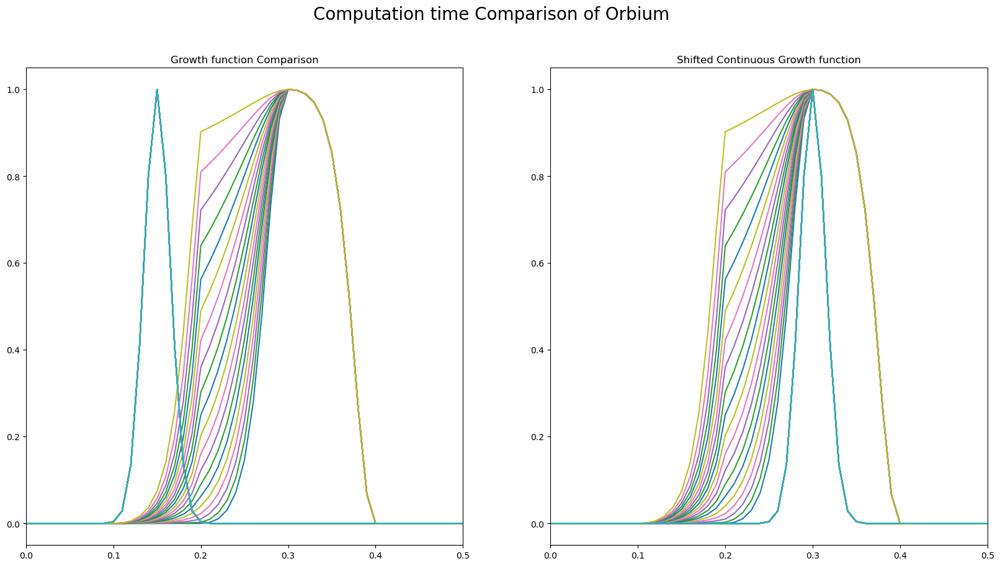

In [4]:
# normalise the quantum state
cells = np.arange(0,1,0.05)
plot_update_Qrule(cells, orbium_params.mu, orbium_params.sigma)

Now we will simulate the semi-quantum lenia. Here we illustrate with the creature called Synpteraserratus sinus labens

In [5]:
# uncomment to show original simulation video
with open('./zoo/encyclopedia.json', "r") as read_file:
    d_load = json.load(read_file)
# choose random creature, you can uncomment and change the creature index as you like

name, param, cell = Board.from_data(d_load[69])
p = Params(R=param["R"], mu=param["m"], sigma=param["s"], size=64, dt=1/param["T"], cells=cell, b=param['b'])
Quantum = np.load('./generation_data/QSynpteraserratussinuslabens_fft_size_64.npz') 
classical= np.load('./generation_data/Synpteraserratussinuslabens_fft_size_64.npz') 

def figure_panels_two(Q,C, cmap='gray'):
  global img1, img2
  fig = plt.figure(figsize=(8,8), dpi=75, frameon=False)
  plt.subplot(121).set_axis_off();  img1 = plt.imshow(Q['generation_0'], vmin=0, cmap=cmap)
  plt.subplot(122).set_axis_off();  img2 = plt.imshow(C['generation_0'], vmin=0, cmap=cmap)
  fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)
  plt.close()
  return fig

def update(i):
  global Quantum,classical, img
  ''' update panels '''
  img1.set_array(Quantum['generation_'+str(i+1)])
  img2.set_array(classical['generation_'+str(i+1)])
  return img,
fig = figure_panels_two(Quantum,classical)
HTML(matplotlib.animation.FuncAnimation(fig, update, frames=300, interval=40).to_jshtml())

We can conclude that the quantum state update immediately made the creature lose its mobility and made some 'explosion' movement. This might be the effect of interference but I think incompatibility of the growth mapping is more likely.

And we can see creatures like orbium cannot survive during the conversion. So much effort is needed to find new type of quantum creatures.

In [27]:
Quantum = np.load('./generation_data/Qorbium_fft_size_64.npz') 
classical= np.load('./generation_data/orbium_fft_size_64.npz') 
fig = figure_panels_two(Quantum,classical)
HTML(matplotlib.animation.FuncAnimation(fig, update, frames=300, interval=40).to_jshtml())

# 5. Experiments On Precision

As already mentioned, lenia is a PDE system with Euler updates. To see it more clearly we can write the original equation in differential form:

$$ \frac{dA^t}{dt} = G(K*A^t) $$

In the paper the author proposed a hypothesis:

* The importance of approximation parameters to self-organization is not limited to
a particular continuous CA framework, or even to continuous CA, but also can be
observed in other discrete approximations of other complex systems that support
self-organizing patterns.

which basically translate to the fact that size of $\delta t$ affects the evolution of lenia. Although we normally have the condition that the smaller the stepsize change, the more precise the Euler's method will be. It is not the case in lenia.

### Step Change

By experimenting with constant step size (Change dt after few loops of updates and see the evolution demonstrate as below. The number showing in the lower video is the stepsize). We found that for different creatures there is an optimal step size. For example, for the classical lenia -- Orbium, this value is around 0.1. While for value much higher than this, it could not survive after few runs and much below this, orbium evolves really slowly though it moves.

In [3]:
pattern_index = 9
dt = np.clip(0.1, 0.001, 1.0)
max_dt = np.clip(0.3, 0.001, 1.0)
min_dt = np.clip(0.001, 0.001, 1.0)
num_frames = min([max([1, 600]), 1024])
error_threshold = max([1e-17, 0.01])

Cell_Pattern = lib.load(lib.index[pattern_index])
pattern = np.asarray(Cell_Pattern["cells"])

# adaptive step size parameters
# dim_x = max([128, pattern.shape[-2]*2])
# dim_y = max([dim_x, pattern.shape[-1]*2])

# code_grid = torch.zeros(1, 1, dim_x, dim_y)

# offset_x = (dim_x - pattern.shape[-2]) // 2
# offset_y = (dim_y - pattern.shape[-1]) // 2

# code_grid[:,:,offset_x:offset_x+pattern.shape[-2], offset_y:offset_y+pattern.shape[-1]] = torch.tensor(pattern).clone()
# code_grid = code_grid.to(my_device)

# sim = Simulator(cells=code_grid,kernel=Kernel().smooth_ring_kernel(dim_x//2, Cell_Pattern["R"]),
#                 growth_fn=Growth_fn(mu=Cell_Pattern["m"], sigma=Cell_Pattern["s"]),type='AOrbium_AdaptiveStep', title=None,
#                 dT=dt, Adaptiveness=[min_dt, error_threshold, max_dt])
# sim.Aanimate(frames=num_frames)
show_videofile('./demo/AOrbium.mp4')

pattern orbium loaded from /Users/peteryang/Downloads/computing-project-sqhy2/zoo/orbium.json


In [4]:
pattern_index = 9
dt = [0.033,0.1,0.3]
num_frames = 512
small_dim = 48
pattern_name = lib.index[pattern_index]

Cell_Pattern = lib.load(lib.index[pattern_index])
pattern = np.asarray(Cell_Pattern["cells"])

dim_x = max([small_dim, pattern.shape[-2]*2])
dim_y = max([dim_x, pattern.shape[-1]*2])

# grid = torch.zeros(1, 1, dim_x, dim_y)

# offset_x = (dim_x - pattern.shape[-2]) // 2
# offset_y = (dim_y - pattern.shape[-1]) // 2

# grid[:,:,offset_x:offset_x+pattern.shape[-2], offset_y:offset_y+pattern.shape[-1]] = torch.tensor(pattern).clone()
# grid = grid.to(my_device)

# slow_grid = 1.0 * grid
# fast_grid = 1.0 * grid 
# type = ''.join(pattern_name.split('_'))

# titles = [f"Step size: {dt[0]:.4f}", f"Step size: {dt[1]:.4f}", f"Step size: {dt[2]:.4f}"]

# this code will generate a video in the demo folder
# sim = Simulator(cells=[slow_grid,grid,fast_grid],kernel=Kernel().smooth_ring_kernel(dim_x//2, Cell_Pattern['R']),growth_fn=Growth_fn(mu=Cell_Pattern["m"], sigma=Cell_Pattern["s"]),type=type+'_StepSize',title=titles,dT=dt)
# sim.Sanimate(frames=num_frames)
show_videofile('./demo/orbium.mp4')

pattern orbium loaded from /Users/peteryang/Downloads/computing-project-sqhy2/zoo/orbium.json


Another example with Scutium gravidus, the best step size is around 0.33. So at least for lenia, it is not the case that the smaller the step size is, the better the Euler update will be.

In [5]:
pattern_index = 16
dt = [0.11,0.33,0.99]
num_frames = 512
small_dim = 48
pattern_name = lib.index[pattern_index]

#load scutium gravidus
Cell_Pattern = lib.load(lib.index[pattern_index])
pattern = np.asarray(Cell_Pattern["cells"])

# dim_x = max([small_dim, pattern.shape[-2]*2])
# dim_y = max([dim_x, pattern.shape[-1]*2])

# # fisrt two 1's are set for different channels
# grid = torch.zeros(1, 1, dim_x, dim_y)

# offset_x = (dim_x - pattern.shape[-2]) // 2
# offset_y = (dim_y - pattern.shape[-1]) // 2

# grid[:,:,offset_x:offset_x+pattern.shape[-2], offset_y:offset_y+pattern.shape[-1]] = torch.tensor(pattern).clone()
# grid = grid.to(my_device)

# slow_grid = 1.0 * grid
# fast_grid = 1.0 * grid 
# type = ''.join(pattern_name.split('_'))

# titles = [f"Step size: {dt[0]:.4f}", f"Step size: {dt[1]:.4f}", f"Step size: {dt[2]:.4f}"]

# sim = Simulator(cells=[slow_grid,grid,fast_grid],kernel=Kernel().smooth_ring_kernel(dim_x//2, Cell_Pattern['R']),growth_fn=Growth_fn(mu=Cell_Pattern["m"], sigma=Cell_Pattern["s"]),type=type+'_StepSize',title=titles,dT=dt)
# sim.Sanimate(frames=num_frames)
show_videofile('./demo/scutiumgravidus.mp4')

pattern scutium_gravidus loaded from /Users/peteryang/Downloads/computing-project-sqhy2/zoo/scutium_gravidus.json


From a computation precision's perspective, different float type is considered with torch's float 16, 32 and 64. We would guess with higher precision, for example, torch 64, the creature would not survive because of the crude approximation for continuity. But to my surprise the following creatures have all evolved normally during the iteration.

In [6]:
pattern_index = 1
dt = [0.33,0.33,0.33]
num_frames = 512
small_dim = 48
pattern_name = lib.index[pattern_index]

Cell_Pattern = lib.load(lib.index[pattern_index])
pattern = np.asarray(Cell_Pattern["cells"])

# dim_x = max([small_dim, pattern.shape[-2]*2])
# dim_y = max([dim_x, pattern.shape[-1]*2])

# grid = torch.zeros(1, 1, dim_x, dim_y)

# offset_x = (dim_x - pattern.shape[-2]) // 2
# offset_y = (dim_y - pattern.shape[-1]) // 2

# grid[:,:,offset_x:offset_x+pattern.shape[-2], offset_y:offset_y+pattern.shape[-1]] = torch.tensor(pattern).clone()
# grid = grid.to(my_device)

# slow_grid = grid.to(torch.float64)
# fast_grid = grid.to(torch.float16)
# type = ''.join(pattern_name.split('_')) + 'Float'

# titles = [f"dtype: torch.float64", f"dtype: torch.float32", f"dtype: torch.float16"]

# sim = Simulator(cells=[slow_grid,grid,fast_grid],kernel=Kernel().smooth_ring_kernel(dim_x//2, Cell_Pattern['R']),growth_fn=Growth_fn(mu=Cell_Pattern["m"], sigma=Cell_Pattern["s"]),type=type+'_StepSize',title=titles,dT=dt)
# sim.Sanimate(frames=num_frames)
show_videofile('./demo/discutiumsolidus6widewavegliderFloat.mp4')

pattern discutium_solidus_6wide_waveglider loaded from /Users/peteryang/Downloads/computing-project-sqhy2/zoo/discutium_solidus_6wide_waveglider.json


In [7]:
pattern_index = 16
dt = [0.33,0.33,0.33]
num_frames = 512
small_dim = 48
pattern_name = lib.index[pattern_index]


Cell_Pattern = lib.load(lib.index[pattern_index])
pattern = np.asarray(Cell_Pattern["cells"])

# dim_x = max([small_dim, pattern.shape[-2]*2])
# dim_y = max([dim_x, pattern.shape[-1]*2])

# grid = np.zeros((dim_x, dim_y))

# offset_x = (dim_x - pattern.shape[-2]) // 2
# offset_y = (dim_y - pattern.shape[-1]) // 2

# grid[offset_x:offset_x+pattern.shape[-2], offset_y:offset_y+pattern.shape[-1]] = pattern
# grid = grid.astype(np.float32)

# slow_grid = grid.astype(np.float64)
# fast_grid = grid.astype(np.float16)
# type = ''.join(pattern_name.split('_')) + 'Float'

# titles = [f"dtype: np.float64", f"dtype: np.float32", f"dtype: np.float16"]

# sim = Simulator(cells=[slow_grid,grid,fast_grid],kernel=Kernel().smooth_ring_kernel(dim_x//2, Cell_Pattern['R']),growth_fn=Growth_fn(mu=Cell_Pattern["m"], sigma=Cell_Pattern["s"]),type=type+'_StepSize',title=titles,dT=dt)
# sim.Sanimate(frames=num_frames)
show_videofile('./demo/scutiumgravidusFloat.mp4')

pattern scutium_gravidus loaded from /Users/peteryang/Downloads/computing-project-sqhy2/zoo/scutium_gravidus.json
